In [1]:
import json
import os

import cv2
import matplotlib.pyplot as plt
import numpy as np
import torch
from ultralytics import YOLO

In [11]:
# script to copy all the images to images/train folder
def copy_images_from_directory(
    source_root,
    destination_root,
    conditions=["fog", "night", "rain", "snow"],
    split="train",
):
    """
    Copy image files from source directories for different conditions to destination directories.

    Args:
    - source_root (str): The root directory containing the source image directories for different conditions.
    - destination_root (str): The root directory where the image files will be copied.
    - conditions (list of str): A list of conditions representing different subdirectories under the source_root.
    """

    for condition in conditions:
        # Destination directory where the images will be copied
        destination_directory = os.path.join(destination_root, split)

        # Source directory containing the image files
        source_directory = os.path.join(source_root, condition, split)

        for folder in os.listdir(source_directory):
            if not folder.startswith("."):
                files = os.listdir(os.path.join(source_directory, folder))
                for file in files:
                    # Check if the file is an image file (assuming all image files have the ".png" extension)
                    if file.endswith(".png"):
                        # Construct the source and destination file paths
                        source_file = os.path.join(source_directory, folder, file)
                        destination_file = os.path.join(destination_directory, file)

                        # Create the destination directory if it doesn't exist
                        os.makedirs(destination_directory, exist_ok=True)

                        # Copy the file from the source to the destination directory
                        with open(source_file, "rb") as src, open(
                            destination_file, "wb"
                        ) as dest:
                            dest.write(src.read())

        print(f"Image files copied successfully for condition: {condition}")


# source_root = "E:\New folder\images"
# destination_root = "E:\New folder\dest"

source_root = "E:\\New folder\\images"
destination_root = "E:\\New folder\\data\\images"

conditions = ["fog", "night", "rain", "snow"]

copy_images_from_directory(source_root, destination_root, conditions, "train")
copy_images_from_directory(source_root, destination_root, conditions, "val")
copy_images_from_directory(source_root, destination_root, conditions, "test")


Image files copied successfully for condition: fog
Image files copied successfully for condition: night
Image files copied successfully for condition: rain
Image files copied successfully for condition: snow
Image files copied successfully for condition: fog
Image files copied successfully for condition: night
Image files copied successfully for condition: rain
Image files copied successfully for condition: snow
Image files copied successfully for condition: fog
Image files copied successfully for condition: night
Image files copied successfully for condition: rain
Image files copied successfully for condition: snow


In [12]:
def convert_annotations_to_yolo_labels(
    json_directory,
    output_directory,
    conditions=["fog", "night", "rain", "snow"],
    split="train",
):
    """
    Convert annotations from ACDC format to YOLO format and save them as text files.

    Args:
    - json_directory (str): Path to the directory containing the JSON annotation files.
    - output_directory (str): Path to the directory where YOLO format labels will be saved.
    - conditions (list of str): List of conditions (e.g., fog, night, rain, snow) for which annotations should be processed.
    """

    # Mapping between ACDC class IDs and YOLO class IDs
    # class_conversion = {
    #     24: 0,  # person
    #     25: 7,  # rider
    #     26: 2,  # car
    #     27: 6,  # truck
    #     28: 4,  # bus
    #     31: 5,  # train
    #     32: 3,  # motorcycle
    #     33: 1,  # bicycle
    # }
    
    class_conversion = {
        # 24: 0,  # person
        # 25: 7,  # rider
        26: 0,  # car
        # 27: 6,  # truck
        # 28: 4,  # bus
        # 31: 5,  # train
        # 32: 3,  # motorcycle
        # 33: 1,  # bicycle
    }

    # Iterate over each condition (e.g., fog, night, rain, snow)
    for condition in conditions:
        # Load JSON data from the current file
        with open(
            f"{json_directory}/{condition}/instancesonly_{condition}_{split}_gt_detection.json",
            "r",
        ) as f:
            data = json.load(f)
        # Iterate over each image in the JSON data
        for image_info in data["images"]:
            # Extract image ID and file name
            image_id = image_info["id"]
            image_filename = image_info["file_name"]

            # Create the output directory if it doesn't exist
            output_path = os.path.join(output_directory, split)
            if not os.path.exists(output_path):
                os.makedirs(output_path)

            # Construct the output file path for YOLO labels

            output_file = os.path.join(
                output_path, f"{image_filename.split('/')[-1].split('.')[0]}.txt"
            )
            # Collect annotations for the current image ID
            image_annotations = [
                annot for annot in data["annotations"] if annot["image_id"] == image_id
            ]

            # Create directory if it doesn't exist
            output_file_dir = os.path.dirname(output_file)
            if not os.path.exists(output_file_dir):
                os.makedirs(output_file_dir)

            # Write annotations to the YOLO label file
            with open(output_file, "w") as label_file:
                for annotation in image_annotations:
                    try:
                        category_id = class_conversion[
                            annotation["category_id"]
                        ]  # converting the id
                    except: # only adding the car labels
                        continue

                    # scaling and transforming the bbox values into yolo format
                    image_height = annotation["segmentation"]["size"][0]
                    image_width = annotation["segmentation"]["size"][1]

                    bbox_transformed = annotation["bbox"]
                    bbox_transformed[0] = bbox_transformed[0] + bbox_transformed[2] / 2
                    bbox_transformed[1] = bbox_transformed[1] + bbox_transformed[3] / 2

                    bbox_scaled = bbox_transformed
                    bbox_scaled[0], bbox_scaled[2] = (
                        int(bbox_scaled[0]) / image_width,
                        int(bbox_scaled[2]) / image_width,
                    )
                    bbox_scaled[1], bbox_scaled[3] = (
                        int(bbox_scaled[1]) / image_height,
                        int(bbox_scaled[3]) / image_height,
                    )
                    bbox_values = " ".join(map(str, annotation["bbox"]))

                    # writing the values to the file
                    label_file.write(f"{category_id} {bbox_values}\n")

        print(f"Text labels created for condition: {condition}")


# Define the directory paths and conditions
json_directory = (
    "E:\\New folder\\annotation\\gt_detection"
)
output_directory = "E:\\New folder\\data\\labels"

# Convert annotations to YOLO labels
convert_annotations_to_yolo_labels(
    json_directory, output_directory, conditions, split="train"
)
convert_annotations_to_yolo_labels(
    json_directory, output_directory, conditions, split="val"
)


Text labels created for condition: fog
Text labels created for condition: night
Text labels created for condition: rain
Text labels created for condition: snow
Text labels created for condition: fog
Text labels created for condition: night
Text labels created for condition: rain
Text labels created for condition: snow


[[0.0, 0.446875, 0.675, 0.016666666666666666, 0.017592592592592594], [0.0, 0.4234375, 0.6768518518518518, 0.01875, 0.025], [0.0, 0.38229166666666664, 0.6768518518518518, 0.033854166666666664, 0.03888888888888889], [0.0, 0.18020833333333333, 0.687037037037037, 0.10260416666666666, 0.09259259259259259], [0.0, 0.4869791666666667, 0.6861111111111111, 0.034895833333333334, 0.046296296296296294], [0.0, 0.5015625, 0.6787037037037037, 0.017708333333333333, 0.03796296296296296], [0.0, 0.5088541666666667, 0.674074074074074, 0.009895833333333333, 0.025925925925925925]]


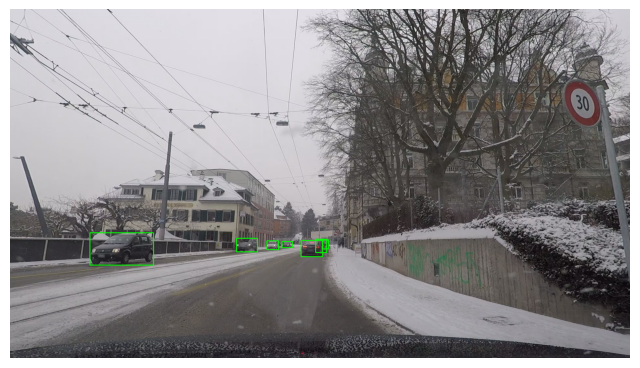

[[0.0, 0.33489583333333334, 0.6824074074074075, 0.020833333333333332, 0.030555555555555555], [0.0, 0.3151041666666667, 0.6759259259259259, 0.0125, 0.018518518518518517], [0.0, 0.46458333333333335, 0.700925925925926, 0.06145833333333333, 0.08148148148148149], [0.0, 0.27760416666666665, 0.6861111111111111, 0.0578125, 0.06574074074074074]]


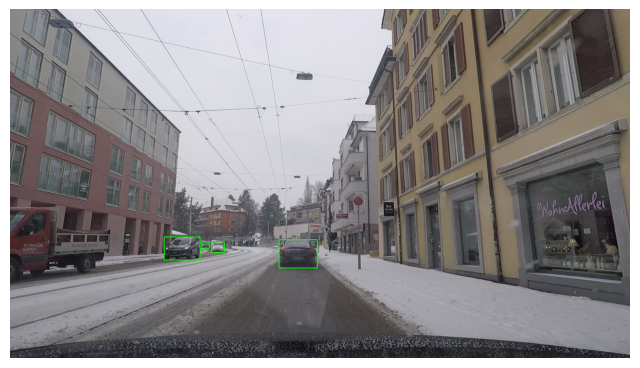

[[0.0, 0.38958333333333334, 0.6768518518518518, 0.04583333333333333, 0.049074074074074076], [0.0, 0.16145833333333334, 0.6611111111111111, 0.018229166666666668, 0.017592592592592594], [0.0, 0.215625, 0.6583333333333333, 0.027604166666666666, 0.025925925925925925], [0.0, 0.06510416666666667, 0.6462962962962963, 0.0203125, 0.020370370370370372], [0.0, 0.011458333333333333, 0.6398148148148148, 0.022916666666666665, 0.03611111111111111]]


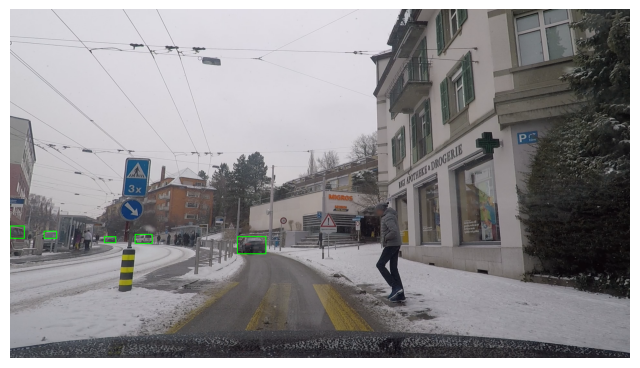

[[0.0, 0.31614583333333335, 0.6694444444444444, 0.014583333333333334, 0.019444444444444445]]


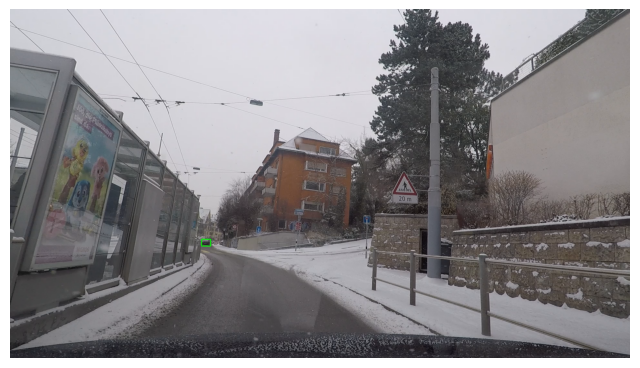

[[0.0, 0.5375, 0.6796296296296296, 0.015104166666666667, 0.03518518518518519], [0.0, 0.30520833333333336, 0.6648148148148149, 0.0421875, 0.040740740740740744], [0.0, 0.23229166666666667, 0.6583333333333333, 0.06822916666666666, 0.06666666666666667], [0.0, 0.0671875, 0.65, 0.13489583333333333, 0.11851851851851852], [0.0, 0.35572916666666665, 0.662962962962963, 0.030208333333333334, 0.03425925925925926], [0.0, 0.34010416666666665, 0.662962962962963, 0.014583333333333334, 0.02962962962962963], [0.0, 0.45, 0.6712962962962963, 0.022395833333333334, 0.03518518518518519], [0.0, 0.4317708333333333, 0.6666666666666666, 0.019791666666666666, 0.024074074074074074], [0.0, 0.484375, 0.6712962962962963, 0.009895833333333333, 0.01574074074074074], [0.0, 0.4765625, 0.6712962962962963, 0.013020833333333334, 0.01574074074074074], [0.0, 0.41770833333333335, 0.6638888888888889, 0.007291666666666667, 0.009259259259259259], [0.0, 0.4036458333333333, 0.6675925925925926, 0.030729166666666665, 0.02129629629629

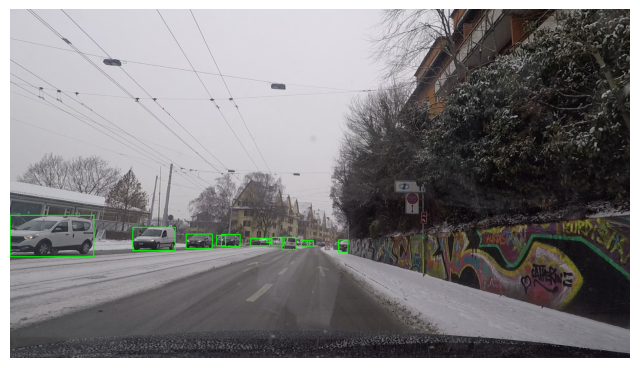

[[0.0, 0.5671875, 0.5564814814814815, 0.0328125, 0.027777777777777776], [0.0, 0.7958333333333333, 0.5703703703703704, 0.06770833333333333, 0.04537037037037037], [0.0, 0.8515625, 0.5851851851851851, 0.07135416666666666, 0.07685185185185185]]


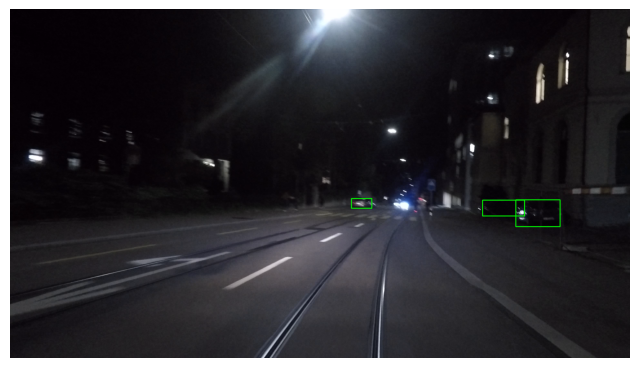

[[0.0, 0.9838541666666667, 0.65, 0.03229166666666667, 0.10740740740740741], [0.0, 0.7765625, 0.575925925925926, 0.14479166666666668, 0.0787037037037037], [0.0, 0.39479166666666665, 0.5462962962962963, 0.035416666666666666, 0.044444444444444446], [0.0, 0.41302083333333334, 0.5435185185185185, 0.016666666666666666, 0.037037037037037035], [0.0, 0.4239583333333333, 0.5435185185185185, 0.016145833333333335, 0.03333333333333333]]


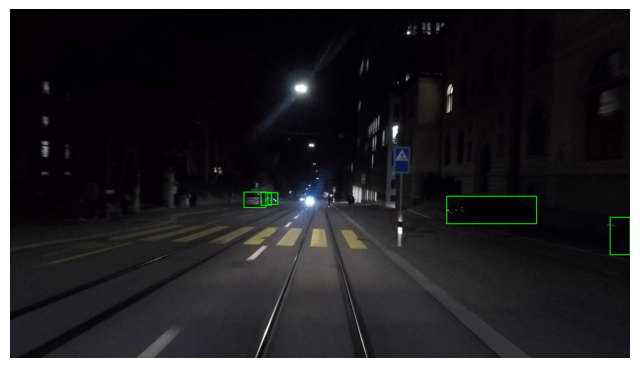

[[0.0, 0.4666666666666667, 0.5398148148148149, 0.016145833333333335, 0.01574074074074074], [0.0, 0.4427083333333333, 0.5398148148148149, 0.020833333333333332, 0.017592592592592594], [0.0, 0.13958333333333334, 0.5888888888888889, 0.19322916666666667, 0.13796296296296295], [0.0, 0.016666666666666666, 0.5796296296296296, 0.033854166666666664, 0.16111111111111112]]


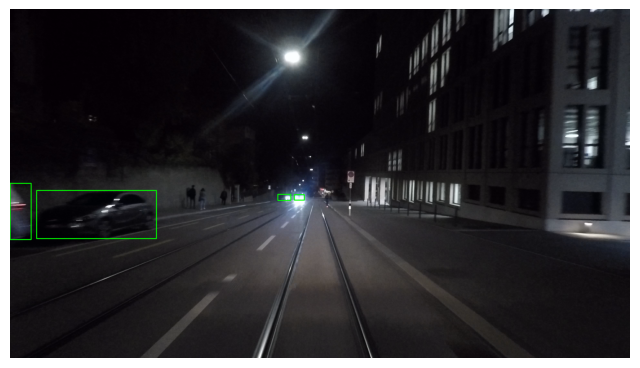

[[0.0, 0.4588541666666667, 0.5407407407407407, 0.01875, 0.020370370370370372], [0.0, 0.41770833333333335, 0.5435185185185185, 0.017708333333333333, 0.027777777777777776], [0.0, 0.4317708333333333, 0.5435185185185185, 0.015625, 0.025]]


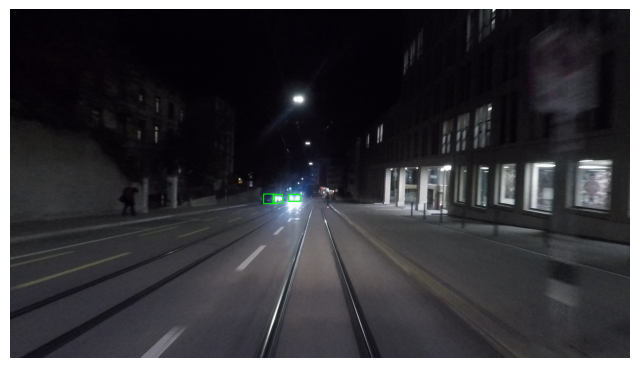

[[0.0, 0.39427083333333335, 0.5472222222222223, 0.04895833333333333, 0.04351851851851852], [0.0, 0.43645833333333334, 0.5462962962962963, 0.0265625, 0.026851851851851852], [0.0, 0.35572916666666665, 0.5537037037037037, 0.04583333333333333, 0.05185185185185185]]


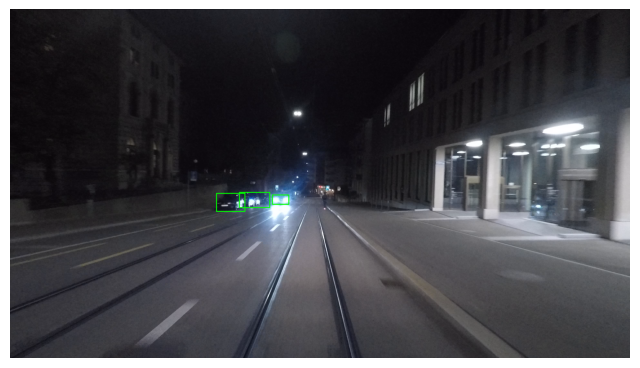

[[0.0, 0.4317708333333333, 0.5287037037037037, 0.022395833333333334, 0.032407407407407406], [0.0, 0.08385416666666666, 0.6805555555555556, 0.16770833333333332, 0.36203703703703705], [0.0, 0.409375, 0.5305555555555556, 0.026041666666666668, 0.03148148148148148]]


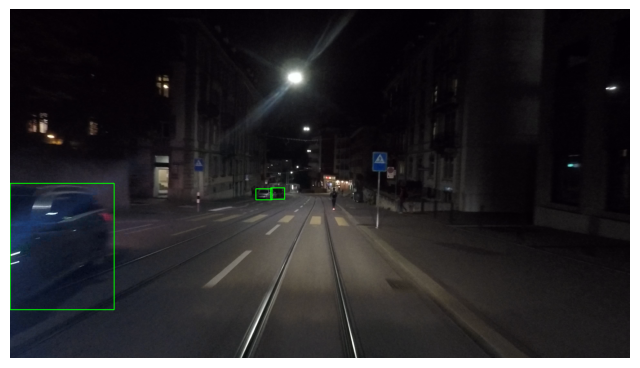

[[0.0, 0.6276041666666666, 0.5703703703703704, 0.0234375, 0.06666666666666667], [0.0, 0.34791666666666665, 0.5046296296296297, 0.009375, 0.012037037037037037], [0.0, 0.1234375, 0.587037037037037, 0.18072916666666666, 0.13796296296296295], [0.0, 0.24635416666666668, 0.5740740740740741, 0.0828125, 0.08888888888888889], [0.0, 0.3458333333333333, 0.5472222222222223, 0.0421875, 0.05925925925925926], [0.0, 0.30572916666666666, 0.5564814814814815, 0.06302083333333333, 0.06944444444444445]]


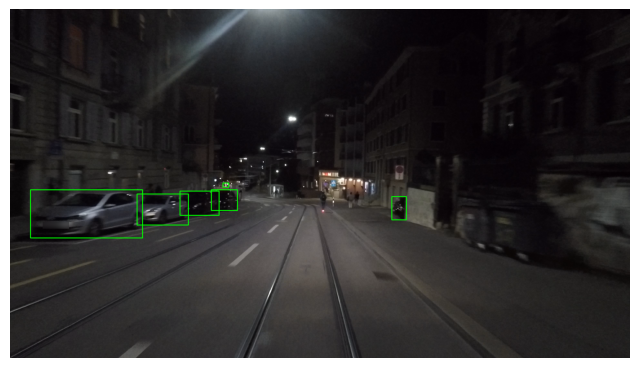

[[0.0, 0.31927083333333334, 0.4962962962962963, 0.07447916666666667, 0.02962962962962963], [0.0, 0.3223958333333333, 0.49444444444444446, 0.010416666666666666, 0.009259259259259259], [0.0, 0.08385416666666666, 0.5861111111111111, 0.16822916666666668, 0.2]]


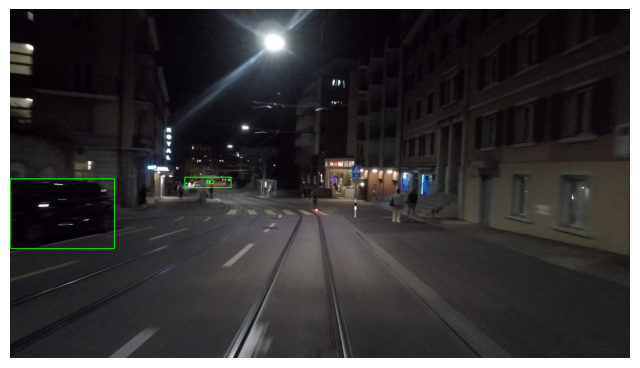

[[0.0, 0.30833333333333335, 0.5037037037037037, 0.025, 0.01574074074074074], [0.0, 0.6828125, 0.5611111111111111, 0.0125, 0.037037037037037035], [0.0, 0.33958333333333335, 0.4981481481481482, 0.0171875, 0.013888888888888888], [0.0, 0.33645833333333336, 0.5074074074074074, 0.0171875, 0.012037037037037037], [0.0, 0.2984375, 0.5148148148148148, 0.018229166666666668, 0.012037037037037037]]


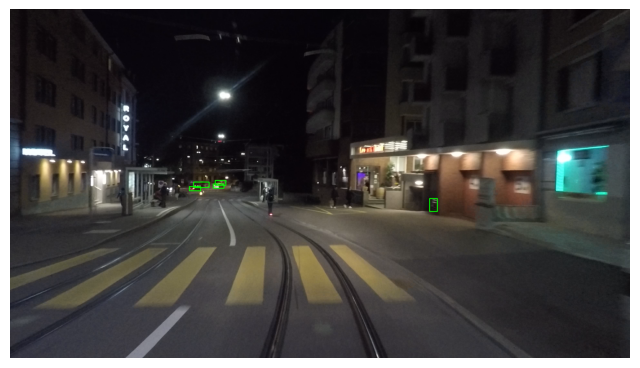

[[0.0, 0.46041666666666664, 0.5074074074074074, 0.0171875, 0.014814814814814815], [0.0, 0.4828125, 0.5009259259259259, 0.0078125, 0.007407407407407408], [0.0, 0.36614583333333334, 0.5055555555555555, 0.016666666666666666, 0.016666666666666666], [0.0, 0.4708333333333333, 0.4925925925925926, 0.0171875, 0.011111111111111112], [0.0, 0.4421875, 0.5009259259259259, 0.01875, 0.014814814814814815], [0.0, 0.39947916666666666, 0.5074074074074074, 0.019791666666666666, 0.014814814814814815]]


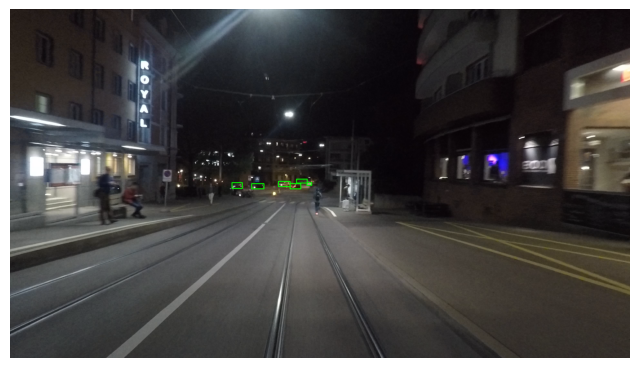

In [14]:
#script to display the image and the bounding box with labels

images = os.listdir("E:\\New folder\\data\\images\\train")

# Load PNG image using OpenCV
class_names = {
    24: 'person',
    25: 'rider',
    26: 'car',
    27: 'truck',
    28: 'bus',
    31: 'train',
    32: 'motorcycle',
    33: 'bicycle',
}

for image_path in images[10:25]:
# for i in range(0, len(image), 300):
    # image_path = image[i]
    image = cv2.imread("E:\\New folder\\data\\images\\train\\"+image_path)
    # Open the file in read mode
    try:
        with open(f"E:\\New folder\\data\\labels\\train\\{image_path.split('.')[0]}.txt", "r") as file:
            # Read all lines from the file into a list
            lines = file.readlines()
        # Define a list to store the integers
        bboxes = []

        # Iterate through each line and parse integers
        for line in lines:
            # Split the line into individual integer values
            # Assuming integers are separated by spaces or commas
            values = line.strip().split()  # Split the line by whitespace characters
            # Convert each value to an integer and add it to the list of integers
            box = [float(i) for i in values]
            bboxes.append(box)
        # print(bboxes)
    except FileNotFoundError:
        print('label not found')
        continue
    
    print(bboxes)
    # Draw bounding boxes on the image
    for bbox in bboxes:
        
        # class_id, x_center, y_center, width, height = map(float, line.split())
        class_id, x_center, y_center, width, height = bbox
            
        # Convert normalized coordinates to pixel coordinates
        image_height, image_width, _ = image.shape
        x_min = int((x_center - width / 2) * image_width)
        y_min = int((y_center - height / 2) * image_height)
        box_width = int(width * image_width)
        box_height = int(height * image_height)
        color = (0, 255, 0)  # Green color for the bounding boxes

        # cv2.rectangle(image, (x_min, y_min), (x_max, y_max), color, thickness)
        cv2.rectangle(image, (x_min, y_min), (x_min + box_width, y_min + box_height), color, 2)
        # print(x_min, y_min, box_width, box_height)

        # Label the bounding box with the class name
        if class_id in class_names:
            class_name = class_names[class_id]
            label = f"{class_name}"
            font = cv2.FONT_HERSHEY_SIMPLEX
            font_scale = 1
            font_thickness = 3
            text_size = cv2.getTextSize(label, font, font_scale, font_thickness)[0]
            cv2.putText(image, label, (x_min, y_min - 5), font, font_scale, color, font_thickness)

    # Convert BGR to RGB for displaying with matplotlib
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Display the image with bounding boxes using matplotlib
    plt.figure(figsize=(8, 6))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

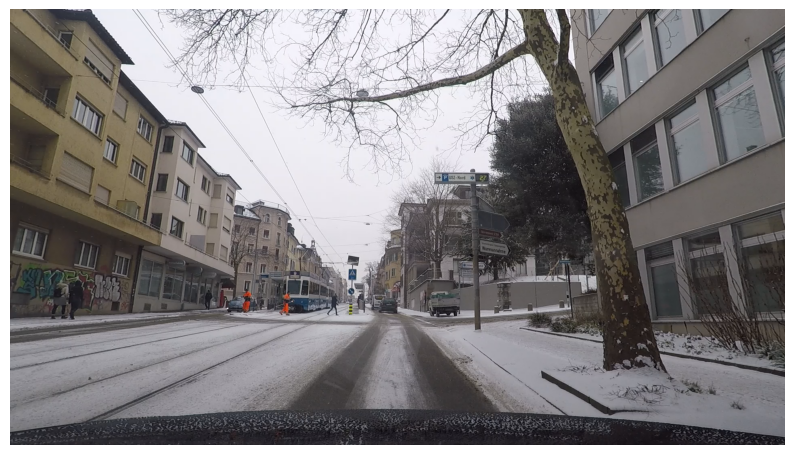

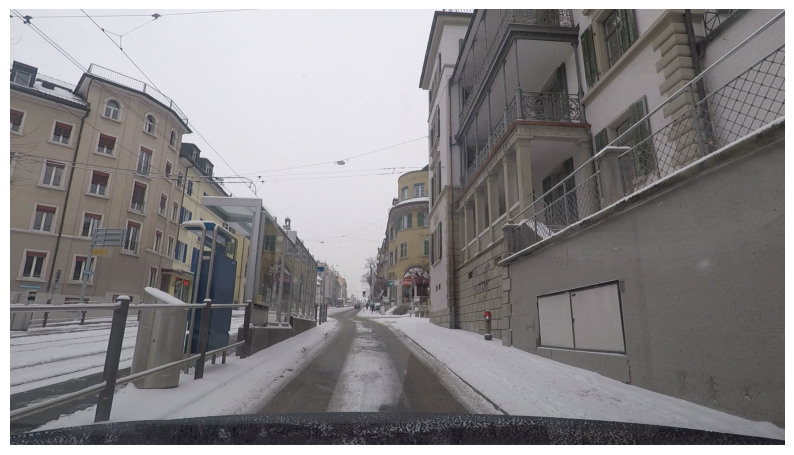

In [15]:
import os
import cv2
import matplotlib.pyplot as plt

# Define class names
class_names = {
    0: 'person',
    1: 'rider',
    2: 'car',
    3: 'truck',
    4: 'bus',
    5: 'train',
    6: 'motorcycle',
    7: 'bicycle',
}

# Define paths
images_path = "E:\\New folder\\data\\images\\train"
labels_path ="E:\\New folder\\data\\labels\\train"

# List image files
images = os.listdir(images_path)

for img_id in images[:2]:
    # Load image
    image = cv2.imread(os.path.join(images_path, img_id))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Load corresponding label file
    label_file = os.path.join(labels_path, f"{os.path.splitext(img_id)[0]}.txt")

    try:
        # Read bounding box coordinates from the label file
        with open(label_file, 'r') as f:
            lines = f.readlines()

        for line in lines:
            # Split the line and extract class ID and bounding box coordinates
            class_id, x_center, y_center, width, height = map(float, line.split())
            
            # Convert normalized coordinates to pixel coordinates
            height, width, _ = image.shape
            x_min = int((x_center - width / 2) * width)
            y_min = int((y_center - height / 2) * height)
            box_width = int(width * width)
            box_height = int(height * height)

            # Draw bounding box on the image
            cv2.rectangle(image, (x_min, y_min), (x_min + box_width, y_min + box_height), (0, 255, 0), 2)

            # Add label text
            class_name = class_names[int(class_id)]
            label = f"{class_name}"
            cv2.putText(image, label, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    except FileNotFoundError:
        print(f"Label file not found for {img_id}")
        continue

    # Plot the image with bounding boxes
    plt.figure(figsize=(10, 8))
    plt.imshow(image)
    plt.axis('off')
    plt.show()


In [17]:
# Load a model
model = YOLO("yolov8n.pt")

# Use the model
results = model.train(
    data="config.yaml", epochs=15, device="mps", freeze=10
)  # train the model

New https://pypi.org/project/ultralytics/8.3.70 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.67  Python-3.12.8 torch-2.5.1+cpu CPU (AMD Ryzen 5 5600H with Radeon Graphics)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=config.yaml, epochs=15, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=mps, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=10, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False

100%|██████████| 755k/755k [00:03<00:00, 203kB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

train: Scanning E:\New folder\data\labels\train... 1600 images, 75 backgrounds, 0 corrupt: 100%|██████████| 1600/1600 [00:21<00:00, 73.57it/s]


train: New cache created: E:\New folder\data\labels\train.cache


val: Scanning E:\New folder\data\labels\val... 406 images, 16 backgrounds, 0 corrupt: 100%|██████████| 406/406 [00:05<00:00, 74.32it/s]


val: New cache created: E:\New folder\data\labels\val.cache
Plotting labels to runs\detect\train3\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs\detect\train3
Starting training for 15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/15         0G      1.535      2.015      1.062        122        640: 100%|██████████| 100/100 [06:21<00:00,  3.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:31<00:00,  2.43s/it]

                   all        406       1865      0.884       0.29      0.449       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/15         0G      1.531      1.459      1.063        100        640: 100%|██████████| 100/100 [04:42<00:00,  2.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:30<00:00,  2.33s/it]

                   all        406       1865      0.648      0.497      0.542      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/15         0G      1.535      1.301      1.076        120        640: 100%|██████████| 100/100 [04:42<00:00,  2.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.28s/it]

                   all        406       1865      0.686      0.494      0.546      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/15         0G      1.495      1.179      1.065        110        640: 100%|██████████| 100/100 [04:40<00:00,  2.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.26s/it]

                   all        406       1865      0.718      0.528      0.583      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/15         0G      1.437      1.086      1.036        112        640: 100%|██████████| 100/100 [04:40<00:00,  2.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.28s/it]

                   all        406       1865      0.714      0.524      0.585      0.347


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/15         0G      1.449      1.097      1.054         33        640: 100%|██████████| 100/100 [04:34<00:00,  2.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.31s/it]

                   all        406       1865      0.752      0.484      0.566      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/15         0G      1.427      1.039      1.039         65        640: 100%|██████████| 100/100 [04:36<00:00,  2.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.25s/it]

                   all        406       1865      0.736      0.502      0.582      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/15         0G      1.397      1.009      1.032         65        640: 100%|██████████| 100/100 [04:34<00:00,  2.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.25s/it]

                   all        406       1865      0.733       0.52      0.597      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/15         0G      1.384     0.9967      1.028         44        640: 100%|██████████| 100/100 [04:35<00:00,  2.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.25s/it]

                   all        406       1865      0.751       0.52      0.601      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/15         0G      1.344     0.9494      1.008         70        640: 100%|██████████| 100/100 [04:35<00:00,  2.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.27s/it]

                   all        406       1865      0.746      0.532      0.611       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/15         0G      1.325     0.9208      1.004         61        640: 100%|██████████| 100/100 [04:34<00:00,  2.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.25s/it]

                   all        406       1865      0.739      0.539      0.616      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/15         0G        1.3     0.8986          1         67        640: 100%|██████████| 100/100 [04:36<00:00,  2.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.26s/it]

                   all        406       1865      0.711      0.561      0.618      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/15         0G      1.278     0.8762     0.9868         63        640: 100%|██████████| 100/100 [04:35<00:00,  2.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.26s/it]

                   all        406       1865      0.759      0.539      0.619      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/15         0G      1.269     0.8616     0.9851         67        640: 100%|██████████| 100/100 [04:38<00:00,  2.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.26s/it]

                   all        406       1865      0.746      0.556      0.627      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/15         0G       1.25     0.8391     0.9865         68        640: 100%|██████████| 100/100 [04:34<00:00,  2.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.24s/it]

                   all        406       1865      0.756      0.551      0.628      0.394



15 epochs completed in 1.312 hours.
Optimizer stripped from runs\detect\train3\weights\last.pt, 6.2MB
Optimizer stripped from runs\detect\train3\weights\best.pt, 6.2MB

Validating runs\detect\train3\weights\best.pt...
Ultralytics 8.3.67  Python-3.12.8 torch-2.5.1+cpu CPU (AMD Ryzen 5 5600H with Radeon Graphics)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:25<00:00,  1.96s/it]


                   all        406       1865      0.759       0.55      0.628      0.394
Speed: 0.9ms preprocess, 33.4ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to runs\detect\train3


In [19]:
#TODO; run this model tonight
# Load a model
model = YOLO("yolov8n.pt")

# Use the model
results = model.train(data="config.yaml", epochs=15, freeze=10)  # train the model

New https://pypi.org/project/ultralytics/8.3.70 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.67  Python-3.12.8 torch-2.5.1+cpu CPU (AMD Ryzen 5 5600H with Radeon Graphics)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=config.yaml, epochs=15, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=10, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=Fals

train: Scanning E:\New folder\data\labels\train.cache... 1600 images, 75 backgrounds, 0 corrupt: 100%|██████████| 1600/1600 [00:00<?, ?it/s]
val: Scanning E:\New folder\data\labels\val.cache... 406 images, 16 backgrounds, 0 corrupt: 100%|██████████| 406/406 [00:00<?, ?it/s]


Plotting labels to runs\detect\train4\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs\detect\train4
Starting training for 15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/15         0G      1.535      2.015      1.062        122        640: 100%|██████████| 100/100 [04:56<00:00,  2.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:31<00:00,  2.42s/it]

                   all        406       1865      0.884       0.29      0.449       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/15         0G      1.531      1.459      1.063        100        640: 100%|██████████| 100/100 [04:43<00:00,  2.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:30<00:00,  2.35s/it]

                   all        406       1865      0.648      0.497      0.542      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/15         0G      1.535      1.301      1.076        120        640: 100%|██████████| 100/100 [04:42<00:00,  2.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.28s/it]

                   all        406       1865      0.686      0.494      0.546      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/15         0G      1.495      1.179      1.065        110        640: 100%|██████████| 100/100 [04:41<00:00,  2.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.27s/it]

                   all        406       1865      0.718      0.528      0.583      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/15         0G      1.437      1.086      1.036        112        640: 100%|██████████| 100/100 [04:41<00:00,  2.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.26s/it]

                   all        406       1865      0.714      0.524      0.585      0.347


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/15         0G      1.449      1.097      1.054         33        640: 100%|██████████| 100/100 [04:36<00:00,  2.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.27s/it]

                   all        406       1865      0.752      0.484      0.566      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/15         0G      1.427      1.039      1.039         65        640: 100%|██████████| 100/100 [04:36<00:00,  2.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.26s/it]

                   all        406       1865      0.736      0.502      0.582      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/15         0G      1.397      1.009      1.032         65        640: 100%|██████████| 100/100 [04:35<00:00,  2.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.25s/it]

                   all        406       1865      0.733       0.52      0.597      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/15         0G      1.384     0.9967      1.028         44        640: 100%|██████████| 100/100 [04:33<00:00,  2.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.24s/it]

                   all        406       1865      0.751       0.52      0.601      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/15         0G      1.344     0.9494      1.008         70        640: 100%|██████████| 100/100 [04:33<00:00,  2.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.24s/it]

                   all        406       1865      0.746      0.532      0.611       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/15         0G      1.325     0.9208      1.004         61        640: 100%|██████████| 100/100 [04:33<00:00,  2.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.25s/it]

                   all        406       1865      0.739      0.539      0.616      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/15         0G        1.3     0.8986          1         67        640: 100%|██████████| 100/100 [04:42<00:00,  2.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:30<00:00,  2.32s/it]

                   all        406       1865      0.711      0.561      0.618      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/15         0G      1.278     0.8762     0.9868         63        640: 100%|██████████| 100/100 [04:53<00:00,  2.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:33<00:00,  2.54s/it]

                   all        406       1865      0.759      0.539      0.619      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/15         0G      1.269     0.8616     0.9851         67        640: 100%|██████████| 100/100 [04:41<00:00,  2.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:29<00:00,  2.24s/it]

                   all        406       1865      0.746      0.556      0.627      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/15         0G       1.25     0.8391     0.9865         68        640: 100%|██████████| 100/100 [04:38<00:00,  2.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:30<00:00,  2.35s/it]

                   all        406       1865      0.756      0.551      0.628      0.394



15 epochs completed in 1.297 hours.
Optimizer stripped from runs\detect\train4\weights\last.pt, 6.2MB
Optimizer stripped from runs\detect\train4\weights\best.pt, 6.2MB

Validating runs\detect\train4\weights\best.pt...
Ultralytics 8.3.67  Python-3.12.8 torch-2.5.1+cpu CPU (AMD Ryzen 5 5600H with Radeon Graphics)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:27<00:00,  2.09s/it]


                   all        406       1865      0.759       0.55      0.628      0.394
Speed: 0.9ms preprocess, 36.6ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to runs\detect\train4



0: 384x640 1 car, 81.4ms
Speed: 3.0ms preprocess, 81.4ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


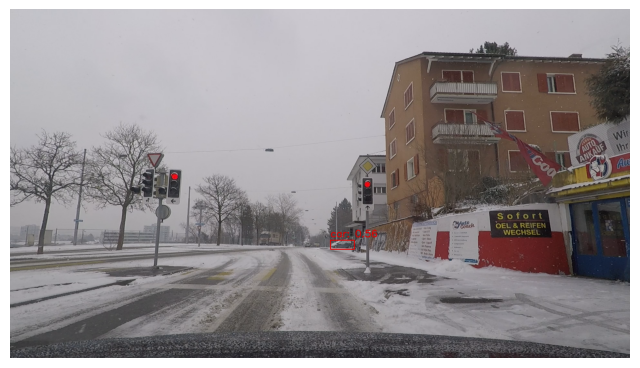


0: 384x640 5 cars, 40.1ms
Speed: 2.0ms preprocess, 40.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


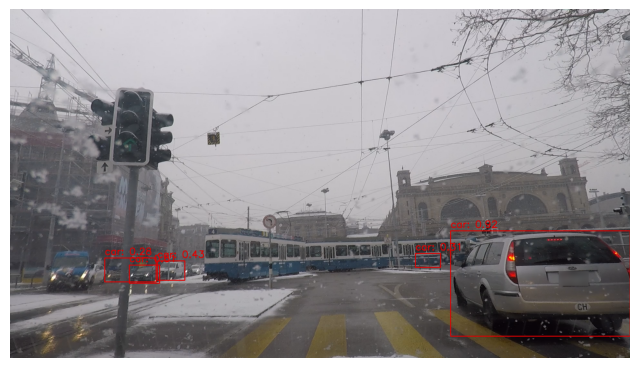


0: 384x640 3 cars, 43.0ms
Speed: 1.0ms preprocess, 43.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


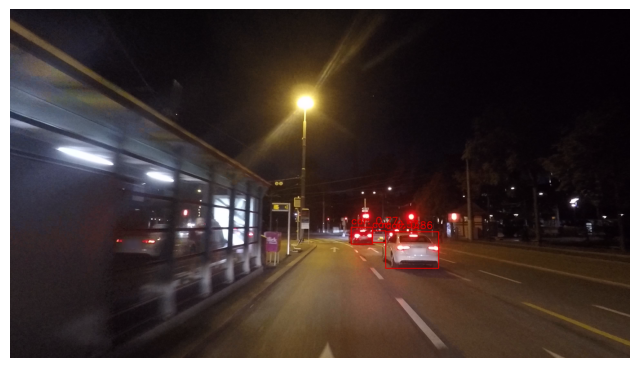


0: 384x640 (no detections), 41.7ms
Speed: 2.2ms preprocess, 41.7ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


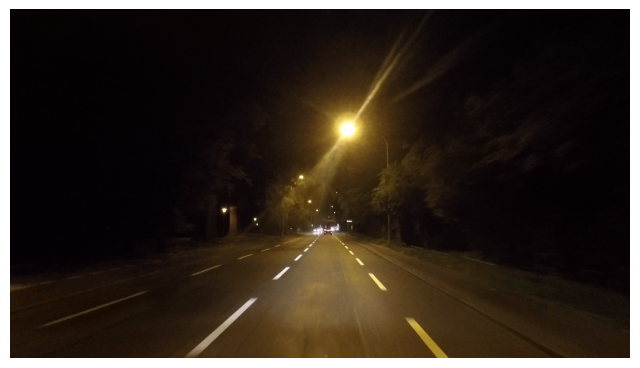


0: 384x640 (no detections), 46.0ms
Speed: 2.0ms preprocess, 46.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


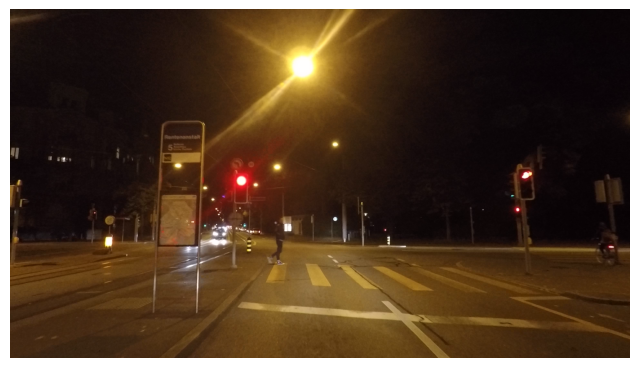


0: 384x640 1 car, 42.6ms
Speed: 2.0ms preprocess, 42.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


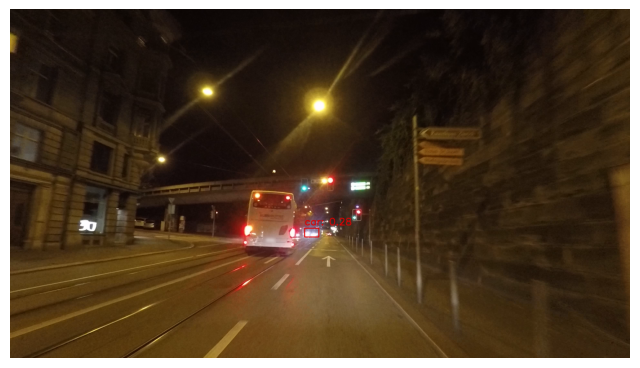


0: 384x640 3 cars, 51.0ms
Speed: 1.0ms preprocess, 51.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


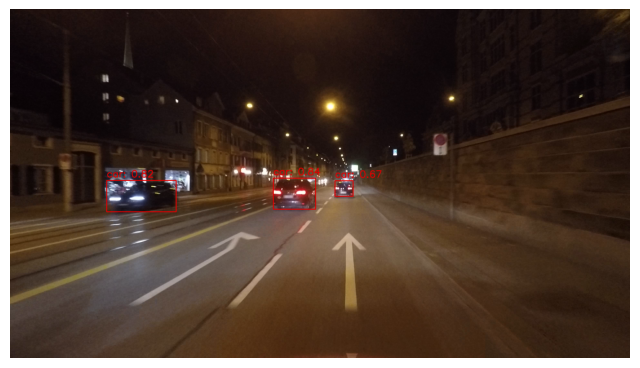


0: 384x640 (no detections), 44.0ms
Speed: 2.0ms preprocess, 44.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


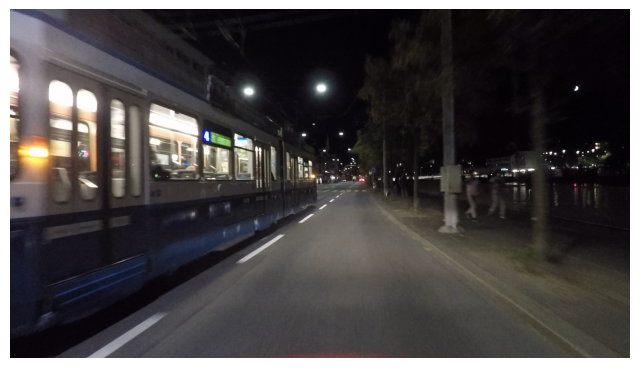


0: 384x640 (no detections), 83.7ms
Speed: 2.0ms preprocess, 83.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


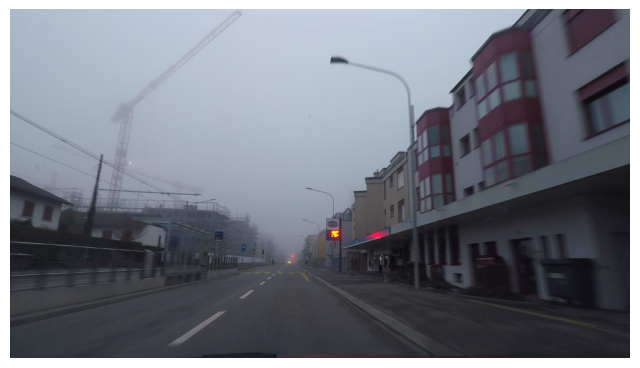


0: 384x640 2 cars, 45.1ms
Speed: 2.0ms preprocess, 45.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


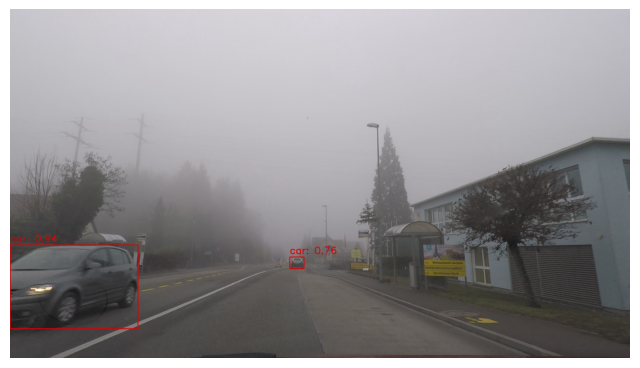


0: 384x640 6 cars, 79.8ms
Speed: 2.0ms preprocess, 79.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


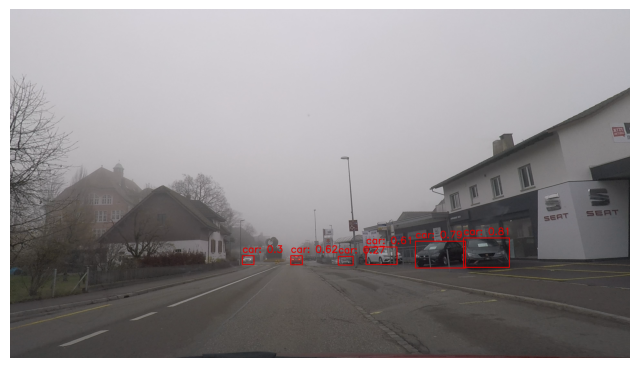


0: 384x640 1 car, 68.6ms
Speed: 1.0ms preprocess, 68.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


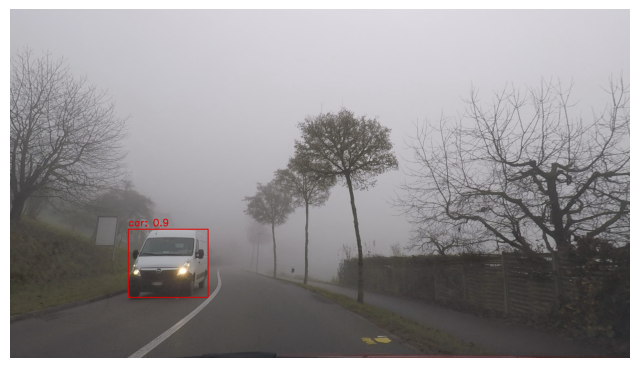


0: 384x640 1 car, 54.3ms
Speed: 5.2ms preprocess, 54.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


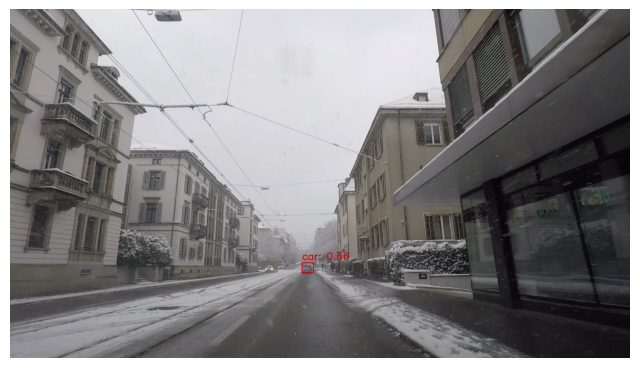


0: 384x640 6 cars, 72.9ms
Speed: 2.4ms preprocess, 72.9ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


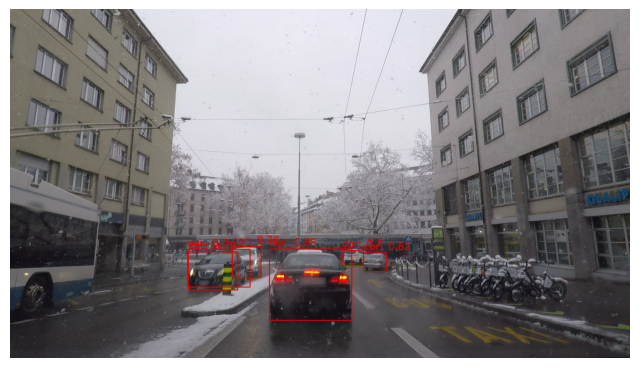


0: 384x640 3 cars, 53.7ms
Speed: 2.4ms preprocess, 53.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


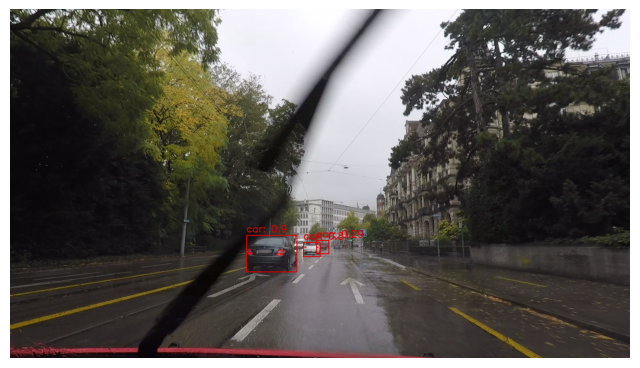


0: 384x640 5 cars, 56.7ms
Speed: 2.2ms preprocess, 56.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


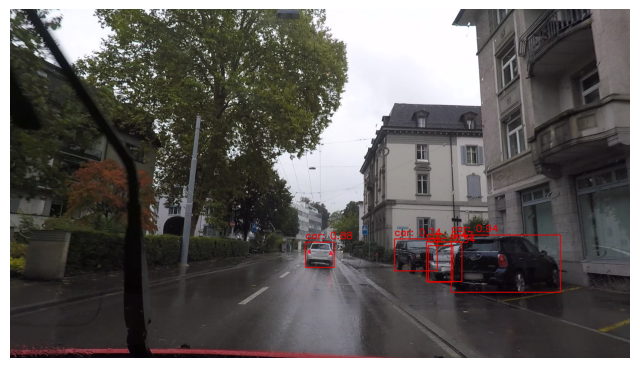


0: 384x640 7 cars, 68.2ms
Speed: 2.2ms preprocess, 68.2ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


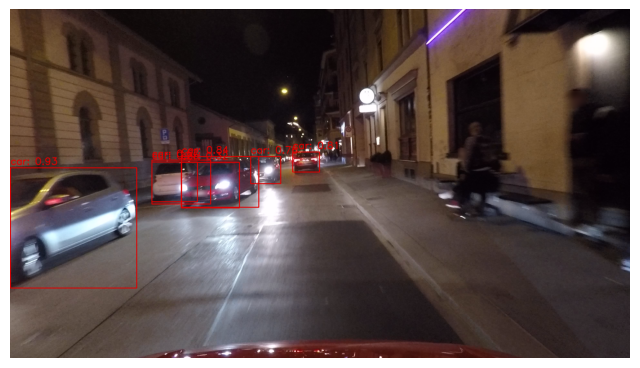


0: 384x640 (no detections), 42.5ms
Speed: 2.0ms preprocess, 42.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


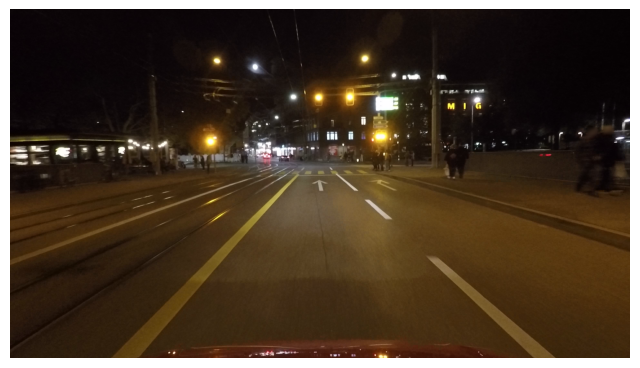


0: 384x640 2 cars, 95.2ms
Speed: 1.0ms preprocess, 95.2ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


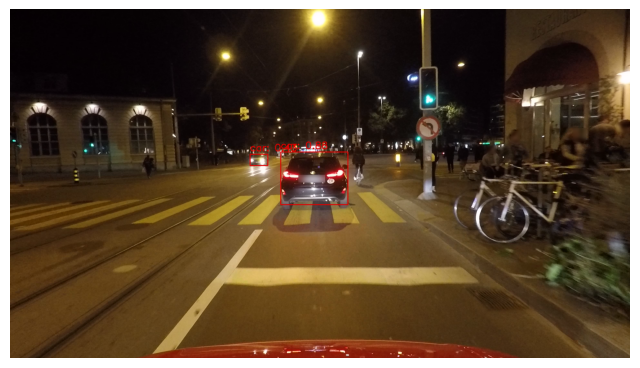


0: 384x640 3 cars, 75.1ms
Speed: 1.0ms preprocess, 75.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


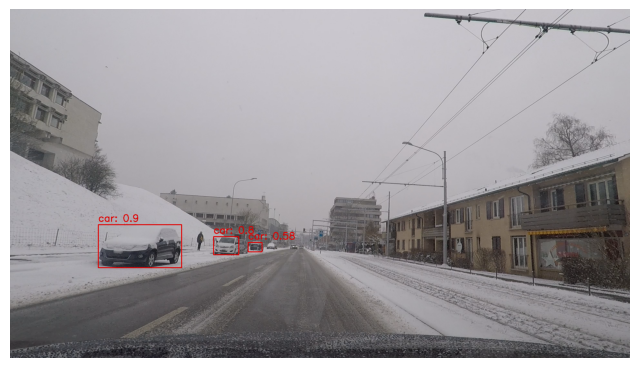


0: 384x640 3 cars, 114.0ms
Speed: 2.0ms preprocess, 114.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


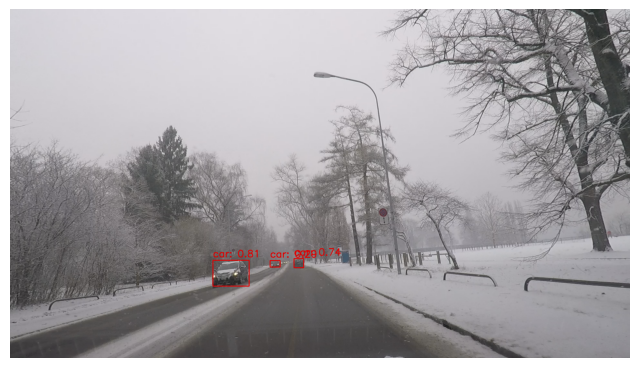


0: 384x640 2 cars, 43.9ms
Speed: 2.0ms preprocess, 43.9ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


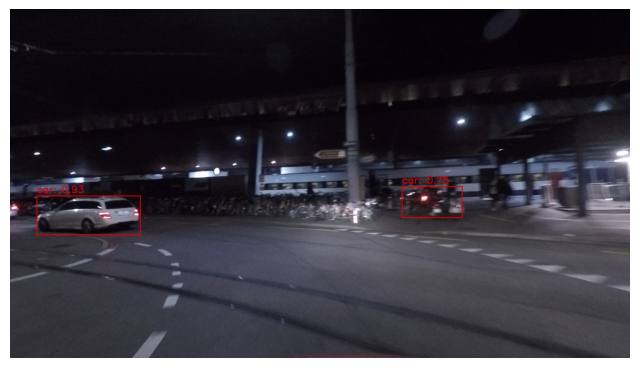


0: 384x640 4 cars, 69.3ms
Speed: 2.3ms preprocess, 69.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


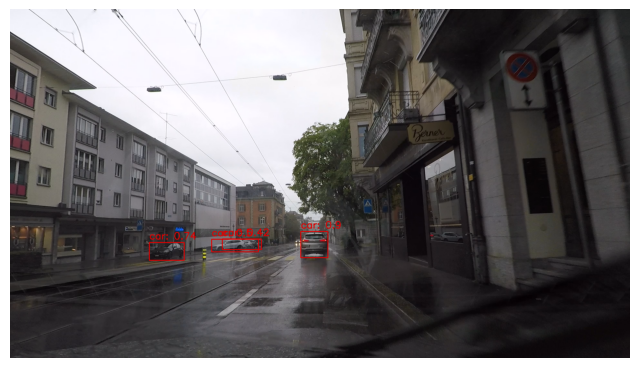


0: 384x640 2 cars, 43.0ms
Speed: 2.0ms preprocess, 43.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


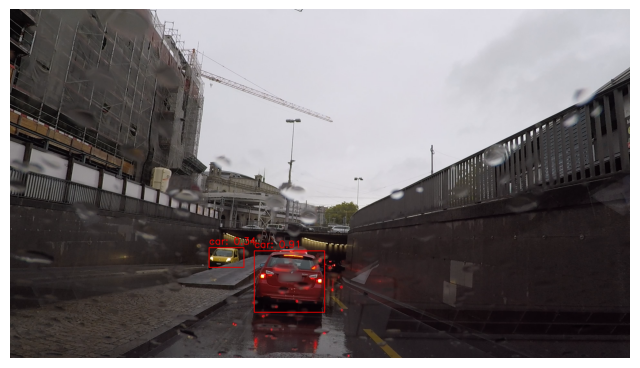


0: 384x640 1 car, 94.2ms
Speed: 2.0ms preprocess, 94.2ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


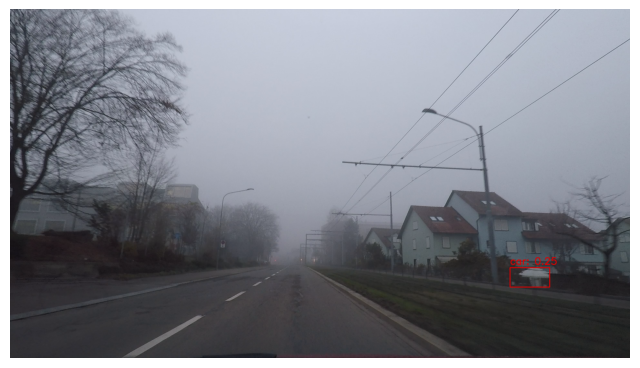


0: 384x640 6 cars, 47.9ms
Speed: 2.0ms preprocess, 47.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


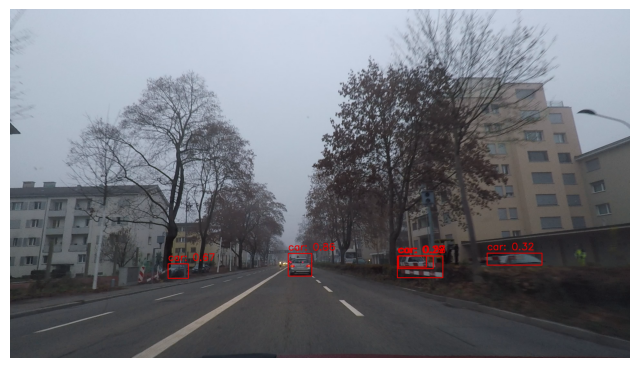


0: 384x640 2 cars, 75.0ms
Speed: 2.0ms preprocess, 75.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


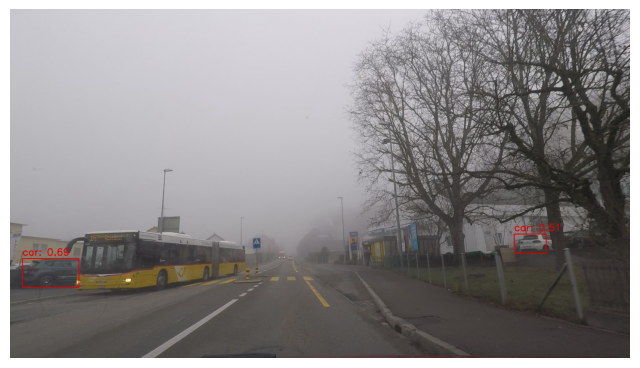


0: 384x640 (no detections), 48.5ms
Speed: 1.0ms preprocess, 48.5ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


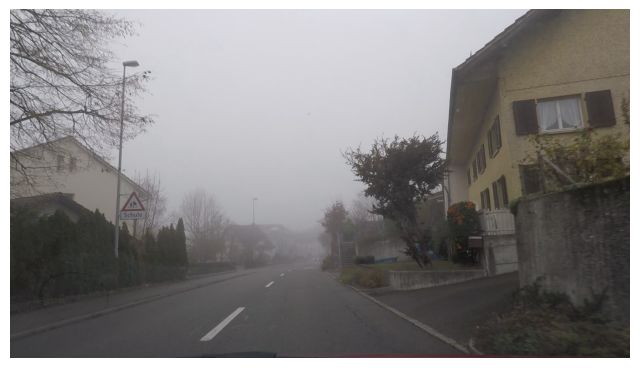


0: 384x640 2 cars, 63.4ms
Speed: 2.0ms preprocess, 63.4ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


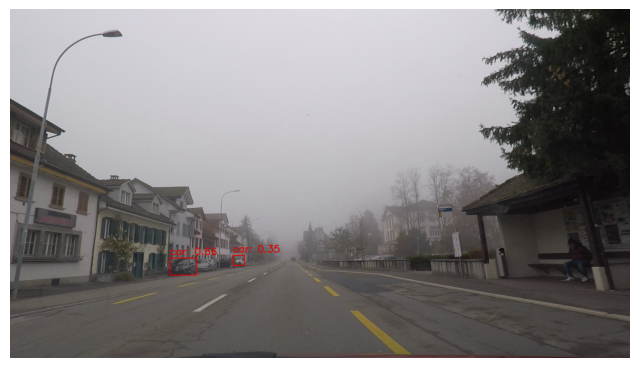


0: 384x640 6 cars, 50.0ms
Speed: 2.0ms preprocess, 50.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


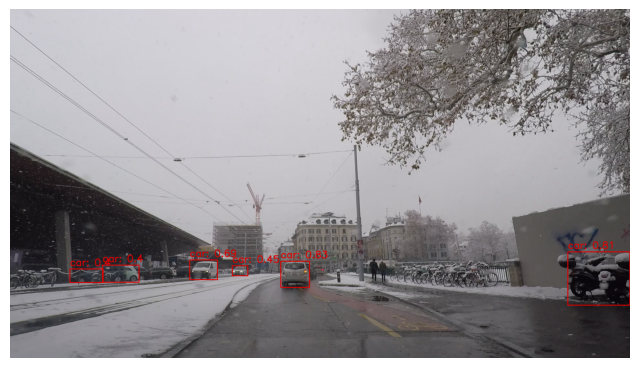


0: 384x640 3 cars, 53.3ms
Speed: 2.0ms preprocess, 53.3ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


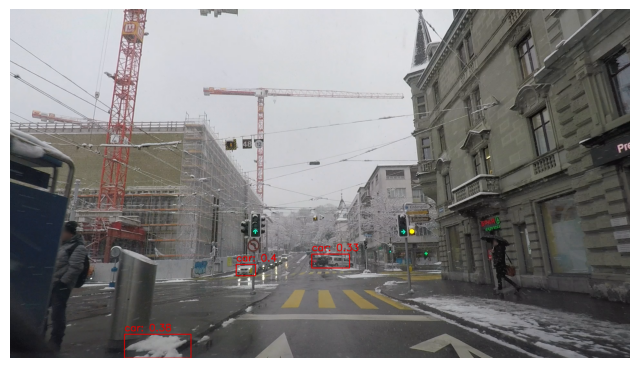


0: 384x640 6 cars, 106.0ms
Speed: 3.4ms preprocess, 106.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


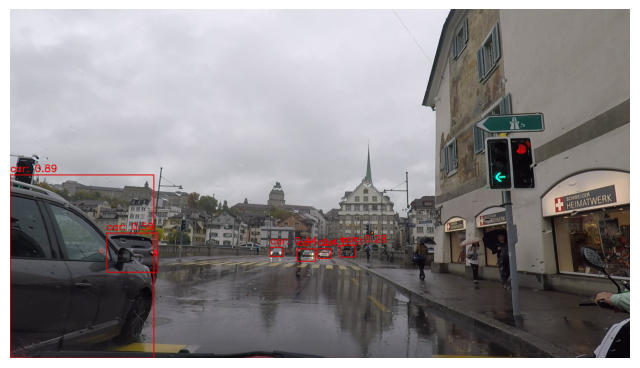


0: 384x640 9 cars, 130.6ms
Speed: 3.0ms preprocess, 130.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


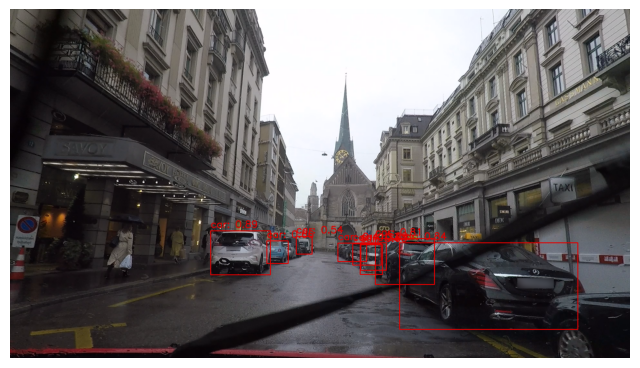


0: 384x640 3 cars, 119.4ms
Speed: 1.8ms preprocess, 119.4ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


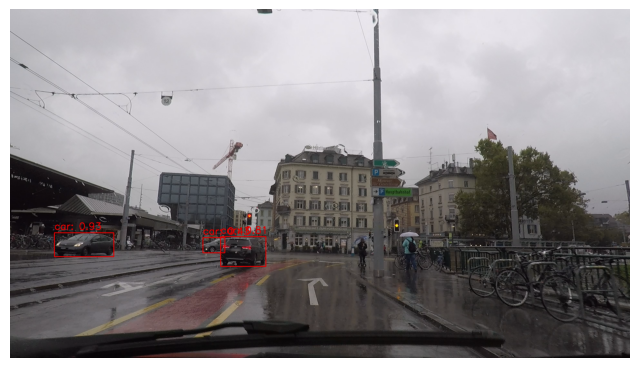


0: 384x640 4 cars, 112.0ms
Speed: 2.0ms preprocess, 112.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


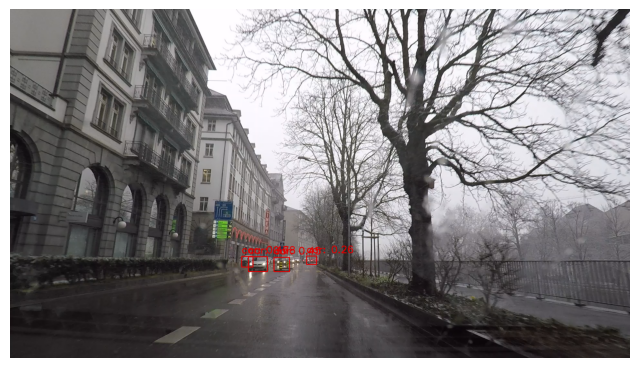


0: 384x640 2 cars, 119.5ms
Speed: 2.1ms preprocess, 119.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


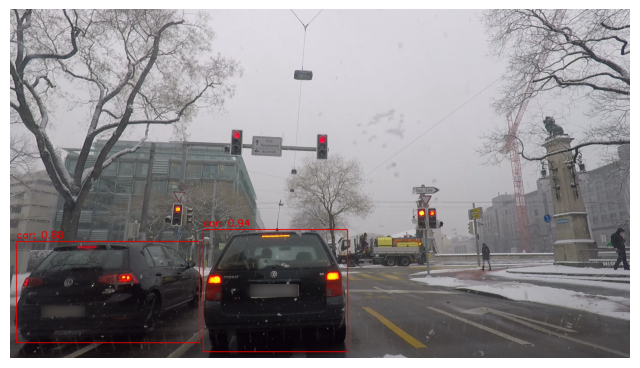


0: 384x640 6 cars, 83.2ms
Speed: 2.0ms preprocess, 83.2ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


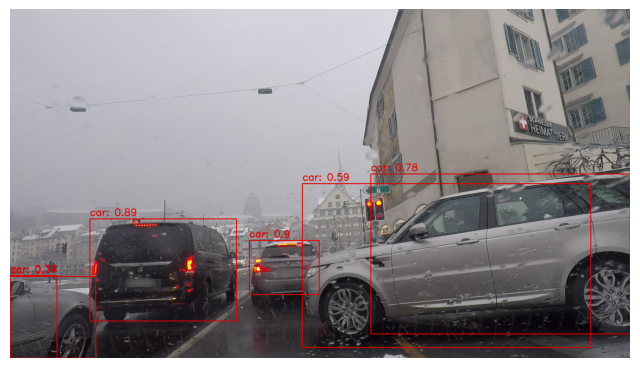


0: 384x640 4 cars, 72.0ms
Speed: 2.0ms preprocess, 72.0ms inference, 11.0ms postprocess per image at shape (1, 3, 384, 640)


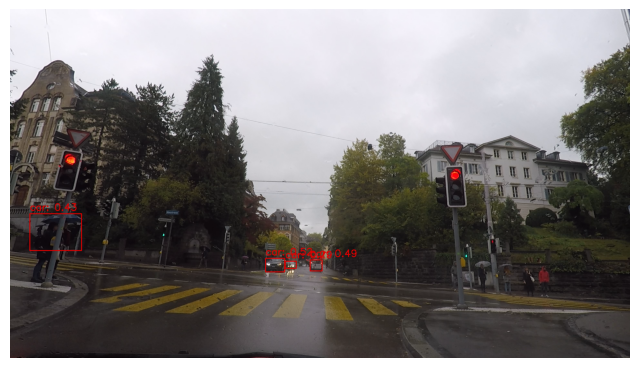


0: 384x640 1 car, 55.3ms
Speed: 2.3ms preprocess, 55.3ms inference, 4.0ms postprocess per image at shape (1, 3, 384, 640)


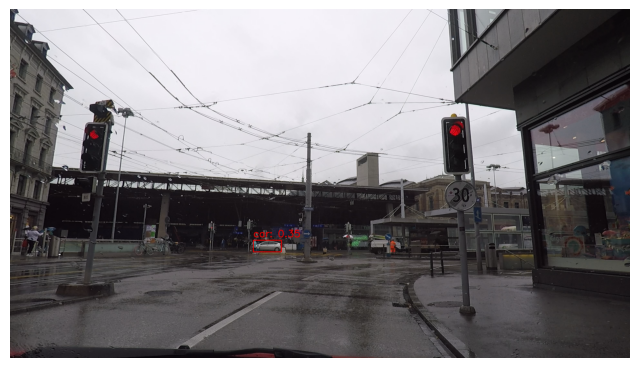


0: 384x640 (no detections), 161.0ms
Speed: 4.0ms preprocess, 161.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


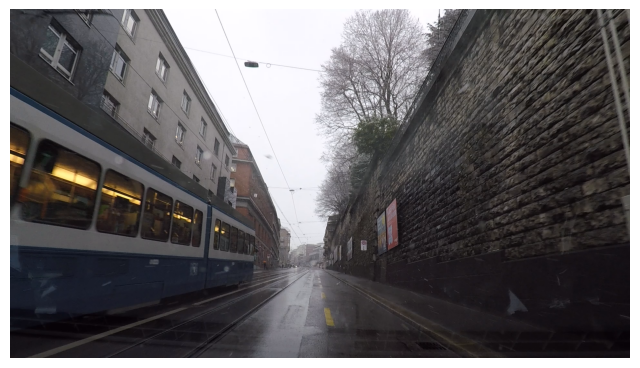


0: 384x640 5 cars, 52.6ms
Speed: 2.5ms preprocess, 52.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


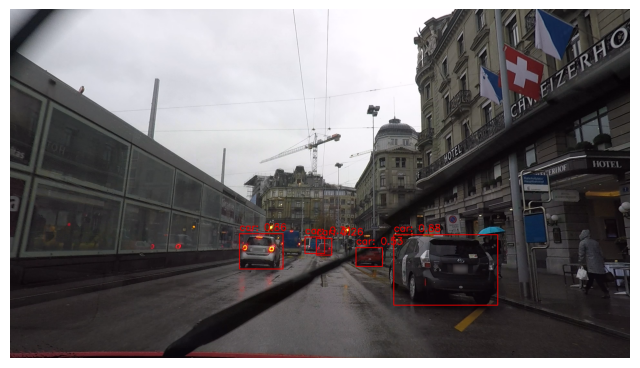

In [21]:
# Testing on test image
test_dataset_dir = "E:\\New folder\\data\\images\\test"

# Get the list of images in the test dataset directory
test_images = os.listdir(test_dataset_dir)

model = YOLO("C:\\Users\\Rohit\\objec\\Object-Detection-in-Adverse-Weather-Conditions\\runs\\detect\\train2\\weights\\best.pt")

# for image_name in test_images[0, len(test_images), 100]:

for img_id in range(0, len(test_images), 49):
    # Load the image
    image_path = os.path.join(test_dataset_dir, test_images[img_id])
    image = cv2.imread(image_path)

    detections = model(image)
    result = detections[0]
    class_id = result.boxes.cls.cpu().numpy()  # Class IDs
    confidence = result.boxes.conf.cpu().numpy()  # Confidence scores

    bboxes = np.array(result.boxes.xyxy.cpu(), dtype="int")  # Bounding boxes
    for i, bbox in enumerate(bboxes):
        (x, y, x2, y2) = bbox
        cv2.rectangle(image, (x, y), (x2, y2), (0, 0, 225), 2)
        label = f"car: {float('{:.2f}'.format(confidence[i]))}"
        cv2.putText(
            image,
            label,
            (x, y - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            1,
            (0, 0, 225),
            2,
        )

    # Convert BGR to RGB for displaying with matplotlib
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Display the image with bounding boxes using matplotlib
    plt.figure(figsize=(8, 6))
    plt.imshow(image_rgb)
    plt.axis("off")
    plt.show()